In [12]:
import os
import cv2
import numpy as np
from IPython.display import clear_output, Image, display, HTML
from PIL import Image as I

import torch
import torchvision
import torchvision.transforms as T

In [13]:
# Constants
VIDEO_FOLDER = 'Data/CCTV-2'
IMAGE_FOLDER = 'Data/cctv-images/images'
MODEL_FOLDER = 'Models'

# Initial exploration
This notebook contains some initial exploration of the images and videos we have available, and how we're going to detect people on those images/videos.

In [14]:
print(f"We have {len(os.listdir(VIDEO_FOLDER))} videos in {VIDEO_FOLDER}")
print(f"We have {len(os.listdir(IMAGE_FOLDER))} images in {IMAGE_FOLDER}")

We have 18 videos in Data/CCTV-2
We have 126 images in Data/cctv-images/images


# Object detection on Images
Sources:
General:
- [The basics of object detection: YOLO, SSD, R-CNN](https://towardsdatascience.com/the-basics-of-object-detection-yolo-ssd-r-cnn-6def60f51c0b)
- [Object Recognition using Python](https://www.javatpoint.com/object-recognition-using-python#:~:text=This%20technology%20is%20capable%20of,systems%2C%20and%20a%20lot%20more.)
- [Computer vision model performance](https://viso.ai/computer-vision/model-performance/)

Yolo:
- [YOLOv7: The most power object detection algorithm](https://viso.ai/deep-learning/yolov7-guide/#:~:text=YOLOv7%20is%20the%20latest%20official,authors%20of%20the%20YOLO%20architecture.)
- [Hugging Face interactive yolo demo](https://huggingface.co/spaces/akhaliq/yolov7)

Single Shot MultiBox Detector (SSD)
- [Object Detection using Single Shot MultiBox Detection (SSD) and Deep Neural Network (DNN)](https://medium.com/featurepreneur/object-detection-using-single-shot-multibox-detection-ssd-and-opencvs-deep-neural-network-dnn-d983e9d52652)

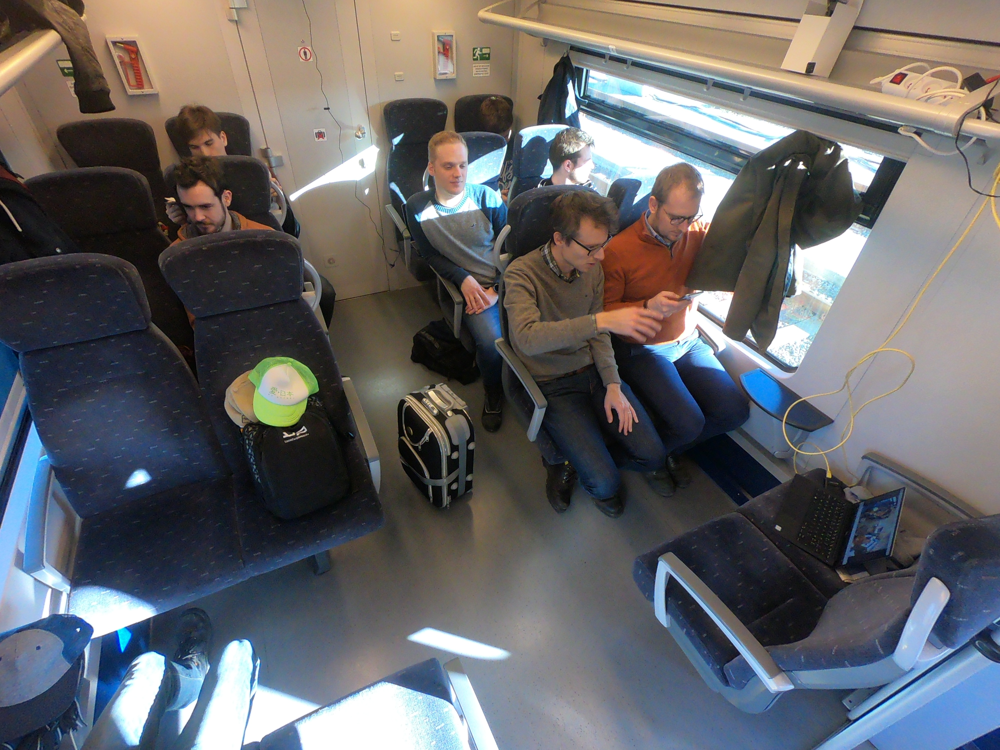

In [15]:
test_image = os.path.join(IMAGE_FOLDER, os.listdir(IMAGE_FOLDER)[94])
assert os.path.exists(test_image)

display_handle = display(None, display_id=True)
img = cv2.imread(test_image, cv.IMREAD_ANYCOLOR)
_, img = cv.imencode('.jpeg', img)
display_handle.update(Image(data=img.tobytes()))

## YOLO
The first model we'll test out is YOLO (You Only Look Once). Recently, YOLOv7 has been released, and has been extremely popular amongst both researchers and companies because at the time of release (2022) it outperformed all other models. The version with the best performance (according to the original paper by Wang, Bochkovskiy, and Liao) is YOLOv7-e6e. 

The quickest way to test the model is to run the following command in the terminal:
```
python detect.py --source ..\..\cctv-images\images\GOPR0633.JPG --weights ..\weights\yolov7.pt
```
This generates the following image:

Models\yolov7\runs\detect\exp\GOPR0633.JPG


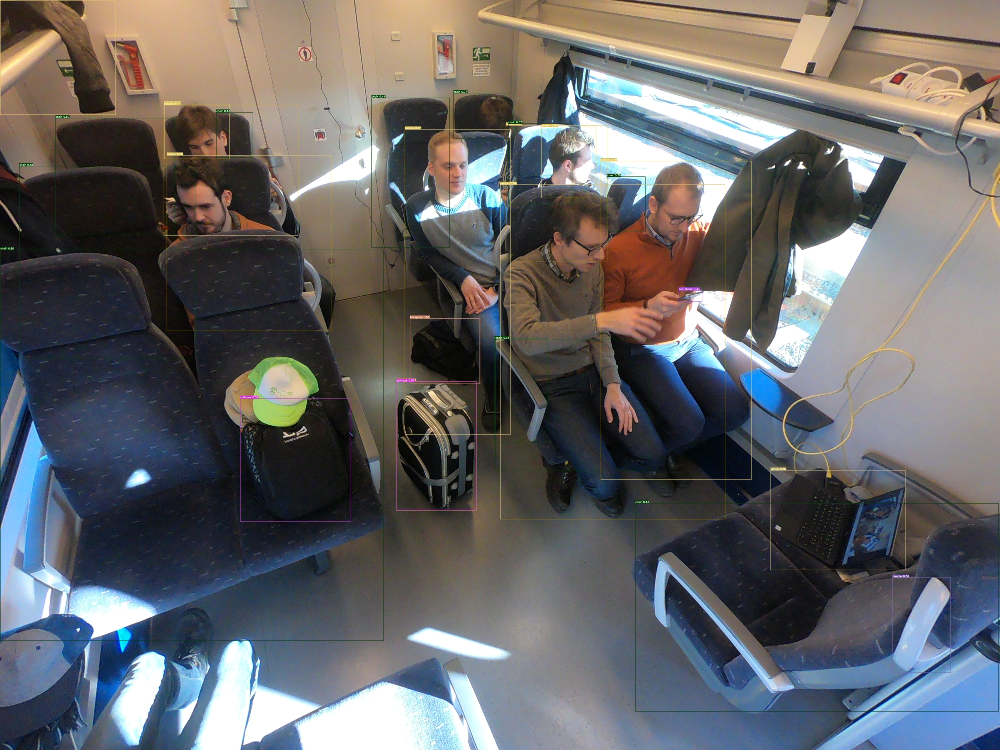

In [16]:
annoted_image = os.path.join(MODEL_FOLDER, 'yolov7', 'runs', 'detect', 'exp', 'GOPR0633.JPG')
print(annoted_image)
assert os.path.exists(annoted_image)

display_handle = display(None, display_id=True)
img = cv2.imread(annoted_image, cv2.IMREAD_ANYCOLOR)
_, img = cv2.imencode('.jpeg', img)
display_handle.update(Image(data=img.tobytes()))

## SSD

In [17]:
PROTOTXT = os.path.join(MODEL_FOLDER, "SSD", "MobileNetSSD_deploy.prototxt")
MODEL = os.path.join(MODEL_FOLDER, "SSD", "MobileNetSSD_deploy.caffemodel")

assert os.path.exists(PROTOTXT)
assert os.path.exists(MODEL)

CLASSES = ["background", "aeroplane", "bicycle", "bird", "boat", "bottle", "bus",  "car", "cat", "chair", "cow", "diningtable", "dog", "horse", "motorbike", "person", "pottedplant", "sheep", "sofa", "train", "tvmonitor"]
COLORS = np.random.uniform(0, 255, size=(len(CLASSES), 3))

In [18]:
image = I.open(test_image)
image_array = np.asarray(image)
h, w, _ = image_array.shape
blob = cv.dnn.blobFromImage(image_array, 0.007843, (300, 300), 127.5)

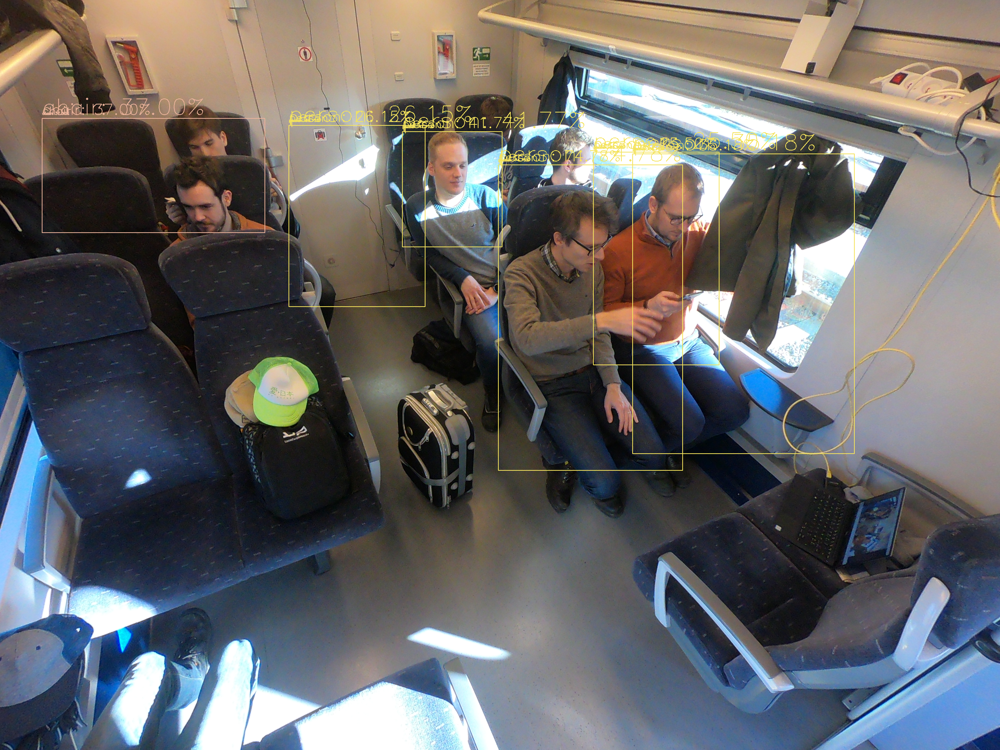

In [56]:
net = cv.dnn.readNetFromCaffe(PROTOTXT, MODEL)
net.setInput(blob)
detections = net.forward()
for i in np.arange(0, detections.shape[2]):
    confidence = detections[0, 0, i, 2]
    if confidence > 0.2:
        idx = int(detections[0, 0, i, 1])
        label = "{}".format(CLASSES[idx])
        box = detections[0, 0, i, 3:7] * np.array([w, h, w, h])
        (startX, startY, endX, endY) = box.astype("int")
        cv2.rectangle(image_array, (startX, startY), (endX, endY), COLORS[idx], 2)
        y = startY - 15 if startY - 15 > 15 else startY + 15
        cv2.putText(image_array, label, (startX, y), cv.FONT_HERSHEY_SIMPLEX, 1.5, COLORS[idx], 2)
data = I.fromarray(image_array)
display(data)

## R-CNN

In [20]:
model = torchvision.models.detection.fasterrcnn_resnet50_fpn(pretrained=True)
model.eval()

C:\Users\Brecht\.conda\envs\cv_nlp\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
C:\Users\Brecht\.conda\envs\cv_nlp\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=FasterRCNN_ResNet50_FPN_Weights.COCO_V1`. You can also use `weights=FasterRCNN_ResNet50_FPN_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/fasterrcnn_resnet50_fpn_coco-258fb6c6.pth" to C:\Users\Brecht/.cache\torch\hub\checkpoints\fasterrcnn_resnet50_fpn_coco-258fb6c6.pth
100%|█████████████████████████████████████████████████████████████| 160M/160M [00:05<00:00, 32.8MB/s]


FasterRCNN(
  (transform): GeneralizedRCNNTransform(
      Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
      Resize(min_size=(800,), max_size=1333, mode='bilinear')
  )
  (backbone): BackboneWithFPN(
    (body): IntermediateLayerGetter(
      (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (bn1): FrozenBatchNorm2d(64, eps=0.0)
      (relu): ReLU(inplace=True)
      (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (layer1): Sequential(
        (0): Bottleneck(
          (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn1): FrozenBatchNorm2d(64, eps=0.0)
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn2): FrozenBatchNorm2d(64, eps=0.0)
          (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn3): FrozenBatchNorm2d(256, eps=0.0)
          (relu): ReLU(

In [23]:
COCO_INSTANCE_CATEGORY_NAMES = [
    '__background__', 'person', 'bicycle', 'car', 'motorcycle', 'airplane', 'bus',
    'train', 'truck', 'boat', 'traffic light', 'fire hydrant', 'N/A', 'stop sign',
    'parking meter', 'bench', 'bird', 'cat', 'dog', 'horse', 'sheep', 'cow',
    'elephant', 'bear', 'zebra', 'giraffe', 'N/A', 'backpack', 'umbrella',   
    'N/A','N/A','handbag', 'tie', 'suitcase', 'frisbee', 'skis', 'snowboard', 
    'sports ball','kite', 'baseball bat', 'baseball glove', 'skateboard',  
    'surfboard', 'tennis racket','bottle', 'N/A', 'wine glass', 'cup', 'fork',
    'knife', 'spoon', 'bowl','banana', 'apple', 'sandwich', 'orange',
    'broccoli', 'carrot', 'hot dog', 'pizza','donut', 'cake', 'chair', 'couch',
    'potted plant', 'bed', 'N/A', 'dining table','N/A', 'N/A', 'toilet', 'N/A',
    'tv', 'laptop', 'mouse', 'remote', 'keyboard', 'cell phone','microwave', 'oven',
    'toaster', 'sink', 'refrigerator', 'N/A', 'book',
    'clock', 'vase', 'scissors', 'teddy bear', 'hair drier', 'toothbrush'
]

In [24]:
def get_prediction(img_path, threshold):
    img = I.open(img_path)
    transform = T.Compose([T.ToTensor()])
    img = transform(img)
    pred = model([img])
    pred_class = [COCO_INSTANCE_CATEGORY_NAMES[i] for i in list(pred[0]['labels'].numpy())]
    pred_boxes = [[(i[0], i[1]), (i[2], i[3])] for i in list(pred[0]['boxes'].detach().numpy())]
    pred_score = list(pred[0]['scores'].detach().numpy())
    pred_t = [pred_score.index(x) for x in pred_score if x>threshold][-1]
    pred_boxes = pred_boxes[:pred_t+1]
    pred_class = pred_class[:pred_t+1]
    return pred_boxes, pred_class

In [80]:
def object_detection_api(img_path, threshold=0.75, rect_th=3, text_size=3, text_th=3):
    boxes, pred_cls = get_prediction(img_path, threshold)
    img = cv2.imread(img_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    for i in range(len(boxes)):
        label = pred_cls[i]
        if label == 'person':
            start_point = (int(boxes[i][0][0]), int(boxes[i][0][1]) )
            end_point = (int(boxes[i][1][0]), int(boxes[i][1][1]) )
            cv2.rectangle(img, start_point, end_point, COLORS[0], rect_th)
    data = I.fromarray(img)
    display(data)

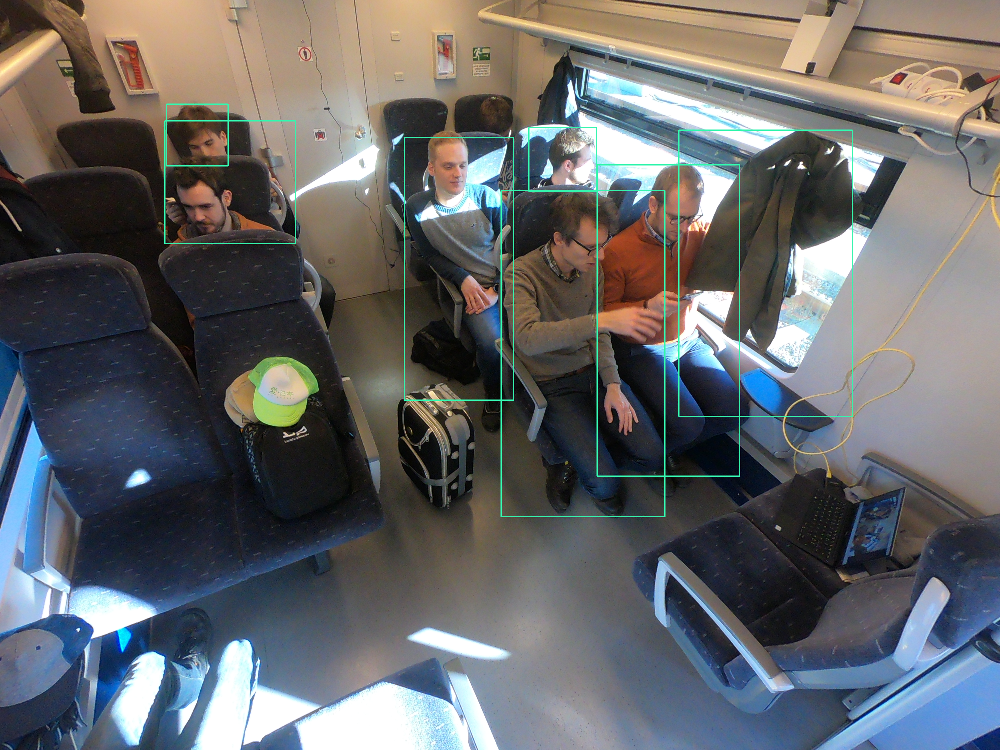

In [81]:
object_detection_api(test_image)

# Working with videos


In [22]:
test_video = os.path.join(VIDEO_FOLDER, os.listdir(VIDEO_FOLDER)[0])
assert os.path.exists(test_video)

Let's first try to play the video.

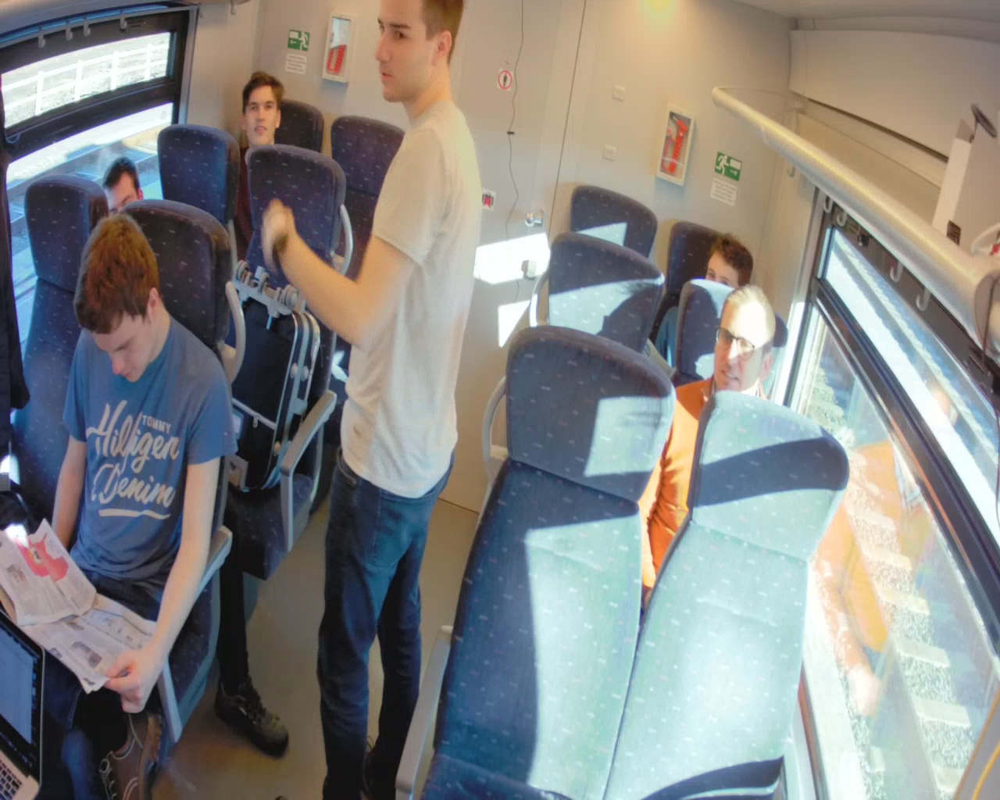

<class 'numpy.ndarray'>


In [23]:
video = cv.VideoCapture(test_video)
display_handle = display(None, display_id=True)
try:
    can_read, frame = video.read()
    print(type(frame))
    while can_read:
        _, frame = cv.imencode('.jpeg', frame)
        display_handle.update(Image(data=frame.tobytes()))
        can_read, frame = video.read()
except KeyboardInterrupt:
    pass
finally:
    video.release()